# 📞 CALL QUALITY ANALYZER

#SETUP & AUDIO PREPROCESSING

In [ ]:
# Audio download and processing
!pip install yt-dlp
!pip install librosa
!pip install soundfile
!pip install matplotlib
!pip install torchaudio
!pip install torch

# Local transcription (Whisper)
!pip install openai-whisper

# Speaker diarization
!pip install pyannote.audio
!pip install speechbrain

# NLP analysis (sentiment)
!pip install transformers

# Optional: progress bar for downloads/transcription
!pip install tqdm


In [ ]:
!pip install -q yt-dlp
!pip install -q git+https://github.com/openai/whisper.git
!pip install -q transformers
!pip install -q pyannote.audio
!pip install faster-whisper


  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


Imports

In [ ]:
import os
import subprocess
import warnings
import librosa
import librosa.display
import matplotlib.pyplot as plt
import soundfile as sf
import numpy as np
import torch
from collections import Counter
from transformers import pipeline
from faster_whisper import WhisperModel
from IPython.display import Audio, display
import torchaudio

warnings.filterwarnings("ignore")

# Download Audio from YouTube

In [ ]:
def download_youtube_audio(url, output_file="call_audio.wav"):

    """
    Downloads audio from YouTube using yt-dlp and saves as WAV.
    """

    print("📥 Downloading YouTube audio via yt-dlp...")
    cmd = f'yt-dlp -x --audio-format wav -o "{output_file}" "{url}"'
    subprocess.run(cmd, shell=True, check=True)
    print(f"✅ Downloaded audio: {output_file}")
    return output_file

#Preprocess Audio (Convert to WAV, Noise Reduction)

In [ ]:
def preprocess_audio(input_path, output_path="processed_call.wav"):
    """
    Loads audio, normalizes it, and saves the processed version.
    Visualization is removed here to speed up processing; use visualize_audio() separately.
    """

    # Load audio with fixed sampling rate (16kHz)
    y, sr = librosa.load(input_path, sr=16000)

    # Normalize audio
    y = librosa.util.normalize(y)

    # Save processed audio
    sf.write(output_path, y, sr)

    print(f"✅ Preprocessed audio saved at: {output_path}")
    return output_path


# 🔊 PLAY ORIGINAL & PROCESSED AUDIO

In [ ]:
def play_audio_comparison(original_path="call_audio.wav", processed_path="processed_call.wav"):
    """
    Plays original and processed audio side by side for comparison.
    """
    print("\n" + "="*40)
    print("🔊  AUDIO COMPARISON: ORIGINAL vs PROCESSED")
    print("="*40)

    print("▶️ Original Audio")
    display(Audio(original_path))

    print("▶️ Processed Audio")
    display(Audio(processed_path))

# Visualize Audio Waveforms

In [ ]:
def visualize_audio(original_path, processed_path):

    """
    Visualizes original and processed audio side by side.
    """

    # Load original audio
    y_orig, sr_orig = librosa.load(original_path, sr=16000)
    # Load processed audio
    y_proc, sr_proc = librosa.load(processed_path, sr=16000)

    # Plot original waveform
    plt.figure(figsize=(12, 3))
    librosa.display.waveshow(y_orig, sr=sr_orig)
    plt.title("Original Audio Waveform")
    plt.show()

    # Plot processed waveform
    plt.figure(figsize=(12, 3))
    librosa.display.waveshow(y_proc, sr=sr_proc)
    plt.title("Processed Audio Waveform")
    plt.show()


# SPEECH TO TEXT TRANSCRIPTION

---



In [ ]:
def transcribe_audio(audio_path):
    """
    Transcribes audio using faster-whisper locally (fast and free).
    Returns transcript text and a visualization of top words.
    """

    print("\n📝 Transcribing audio using local Whisper...")
    model = WhisperModel("small", device="cpu")  # 'small' is fast, accurate enough

    segments, info = model.transcribe(audio_path)
    transcript_text = " ".join([seg.text for seg in segments])

    print("\n📝 Transcript Sample:\n", transcript_text[:200], "...")

    # Show top 10 most frequent words
    words = transcript_text.lower().split()
    common_words = Counter(words).most_common(10)
    plt.figure(figsize=(7, 4))
    plt.bar([w[0] for w in common_words], [w[1] for w in common_words])
    plt.title("Top 10 Most Frequent Words")
    plt.ylabel("Frequency")
    plt.show()

    return {"text": transcript_text}


# Speaker Diarization

In [ ]:
from pyannote.audio import Pipeline

In [ ]:
def speaker_diarization(audio_path):

    """
    Identifies speakers using pyannote.audio pipeline.
    Returns speaker segments and visual timeline.
    """

    print("\n🎙️ Running speaker diarization...")
    pipeline = Pipeline.from_pretrained("pyannote/speaker-diarization",
                                        use_auth_token="REMOVED")
    diarization = pipeline(audio_path)

    speaker_segments = []
    for turn, _, speaker in diarization.itertracks(yield_label=True):
        speaker_segments.append((turn.start, turn.end, int(speaker.split("_")[-1])))

    # Visualize speaker timeline
    fig, ax = plt.subplots(figsize=(10, 3))
    for (start, end, spk) in speaker_segments:
        ax.plot([start, end], [spk, spk], lw=6, label=f"Speaker {spk}")
    ax.set_title("Speaker Timeline")
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Speaker")
    plt.show()

    # Calculate talk-time percentage
    speaker_times = {}
    for s, e, spk in speaker_segments:
        speaker_times[spk] = speaker_times.get(spk, 0) + (e - s)

    total_time = sum(speaker_times.values())
    for spk, t in speaker_times.items():
        print(f"🕒 Speaker {spk}: {t:.2f}s ({(t/total_time)*100:.1f}%)")

    return speaker_segments, speaker_times

# Conversation Analysis

In [ ]:
from transformers import pipeline

In [ ]:
def analyze_conversation(transcription_result, speaker_segments):

    """
    Analyzes the transcript for questions, longest monologue,
    sentiment, and actionable insight.
    """

    transcript_text = transcription_result["text"]

    # 1. Count Questions
    question_count = transcript_text.count("?")
    print(f"❓ Questions Asked: {question_count}\n")

    # 2. Longest Monologue
    longest_monologue = 0
    for s, e, spk in speaker_segments:
        longest_monologue = max(longest_monologue, e - s)
    print(f"🗨️ Longest Monologue: {longest_monologue:.2f} sec\n")

    # 3. Sentiment
    sentiment_model = pipeline("sentiment-analysis")
    sentiment_result = sentiment_model(transcript_text[:500])
    sentiment = sentiment_result[0]["label"]
    score = sentiment_result[0]["score"]
    print(f"😊 Sentiment: {sentiment} ({score:.2f})\n")

    # 4. Actionable Insight
    insight = "Good conversation balance."
    if sentiment.upper() == "NEGATIVE":
        insight = "Customer seems unhappy. Improve tone next time."
    elif question_count > 5:
        insight = "Many questions asked. Ensure they are open-ended."

    print(f"💡 Insight: {insight}\n")

    # Visualization: Sentiment Pie
    plt.figure(figsize=(5, 5))
    colors = ["#4CAF50" if sentiment=="POSITIVE" else "#F44336", "#B0BEC5"]
    plt.pie([score, 1-score], labels=[sentiment, "Other"], autopct='%1.1f%%', colors=colors)
    plt.title("Call Sentiment")
    plt.show()

    return {
        "questions": question_count,
        "longest_monologue": longest_monologue,
        "sentiment": sentiment,
        "insight": insight
    }

# MAIN FUNCTION TO RUN ALL STEPS

In [ ]:
def analyze_call(youtube_url):

    """
    Full pipeline to analyze a sales call from YouTube URL.
    """

    print("\n" + "="*40)
    print("📞  CALL QUALITY ANALYZER - START")
    print("="*40)

    try:
        # STEP 1: Download & Preprocess
        print("\n🔹 STEP 1: Downloading & Preprocessing Audio...")
        audio_file = download_youtube_audio(youtube_url)
        processed_audio = preprocess_audio(audio_file)

        # STEP 1b: Play original vs processed audio
        play_audio_comparison(audio_file, processed_audio)

        # STEP 1c: Show waveform visualization (Before/After)
        visualize_audio(audio_file, processed_audio)

        # STEP 2: Transcription
        print("\n🔹 STEP 2: Transcribing Audio...")
        transcription_result = transcribe_audio(processed_audio)

        # STEP 3: Speaker Diarization
        print("\n🔹 STEP 3: Identifying Speakers...")
        speaker_segments, speaker_times = speaker_diarization(processed_audio)

        # Map speaker IDs to labels
        speaker_labels = {0: "Sales", 1: "Customer"}

        # Update speaker_times dictionary with labels for easier display
        speaker_times_labeled = {speaker_labels[k]: v for k, v in speaker_times.items()}

        # STEP 4: Conversation Analysis
        print("\n🔹 STEP 4: Analyzing Conversation...")
        analysis_results = analyze_conversation(transcription_result, speaker_segments)

        # Final Summary
        print("\n" + "="*40)
        print("📊  FINAL SUMMARY")
        print("="*40)
        print(f"🕒 Talk-Time Ratio:")
        for spk, t in speaker_times_labeled.items():
            print(f"   {spk}: {t / sum(speaker_times_labeled.values()) * 100:.1f}%")


        print(f"❓ Total Questions Asked: {analysis_results['questions']}")
        print(f"🗨️ Longest Monologue: {analysis_results['longest_monologue']:.2f} sec")
        print(f"😊 Overall Sentiment: {analysis_results['sentiment'].upper()}")
        print(f"💡 Actionable Insight: {analysis_results['insight']}")
        print("="*40)
        print("✅ Analysis Complete!")
        print("📂 Processed Audio File:", processed_audio)

    except Exception as e:
        print("\n❌ ERROR: Something went wrong.")
        print(f"Details: {str(e)}")


Lets test it


📞  CALL QUALITY ANALYZER - START

🔹 STEP 1: Downloading & Preprocessing Audio...
📥 Downloading YouTube audio via yt-dlp...
✅ Downloaded audio: call_audio.wav
✅ Preprocessed audio saved at: processed_call.wav

🔊  AUDIO COMPARISON: ORIGINAL vs PROCESSED
▶️ Original Audio


▶️ Processed Audio


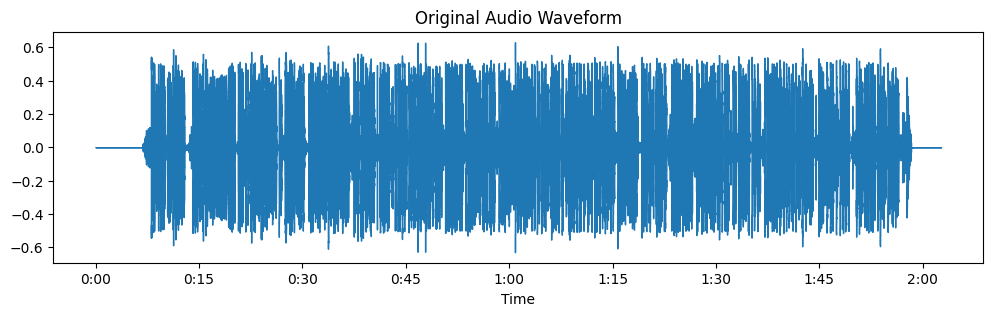

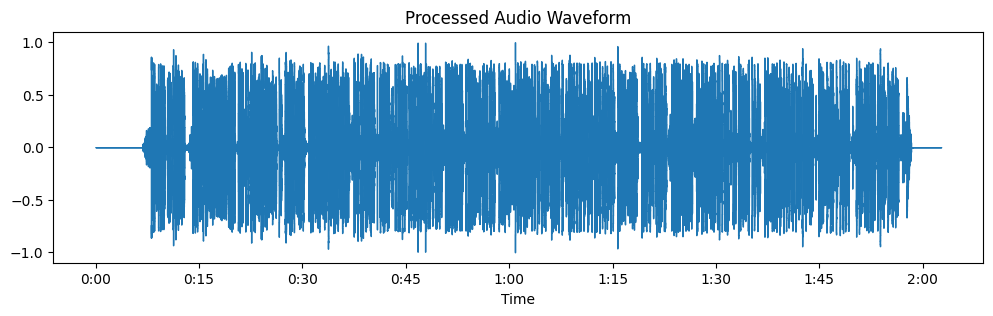


🔹 STEP 2: Transcribing Audio...

📝 Transcribing audio using local Whisper...

📝 Transcript Sample:
  Thank you for calling Nissan. My name is Lauren. Can I have your name?  Yeah, my name is John Smith.  Thank you, John. How can I help you?  I was just calling about to see how much it would cost to u ...


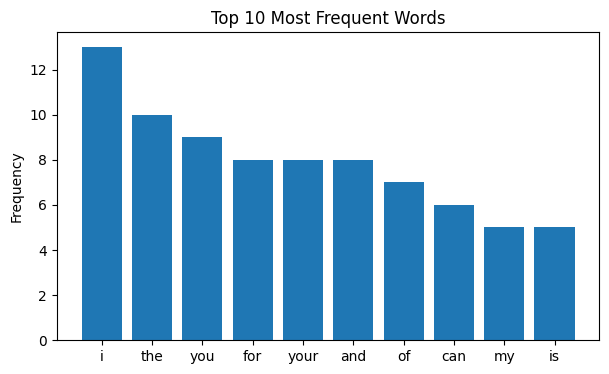


🔹 STEP 3: Identifying Speakers...

🎙️ Running speaker diarization...


INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.5.4 to v2.5.5. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint ../root/.cache/torch/pyannote/models--pyannote--segmentation/snapshots/c4c8ceafcbb3a7a280c2d357aee9fbc9b0be7f9b/pytorch_model.bin`
INFO:speechbrain.utils.fetching:Fetch hyperparams.yaml: Using symlink found at '/root/.cache/torch/pyannote/speechbrain/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-ecapa-voxceleb' if not cached


Model was trained with pyannote.audio 0.0.1, yours is 3.4.0. Bad things might happen unless you revert pyannote.audio to 0.x.
Model was trained with torch 1.10.0+cu102, yours is 2.8.0+cu126. Bad things might happen unless you revert torch to 1.x.


DEBUG:speechbrain.utils.parameter_transfer:Collecting files (or symlinks) for pretraining in /root/.cache/torch/pyannote/speechbrain.
INFO:speechbrain.utils.fetching:Fetch embedding_model.ckpt: Using symlink found at '/root/.cache/torch/pyannote/speechbrain/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /root/.cache/torch/pyannote/speechbrain/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Using symlink found at '/root/.cache/torch/pyannote/speechbrain/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /root/.cache/torch/pyannote/speechbrain/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Using symlink found at '/root/.cache/torch/pyannote/speechbrain/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["classifier"] = /root/.cache/torch/pyannote/speech

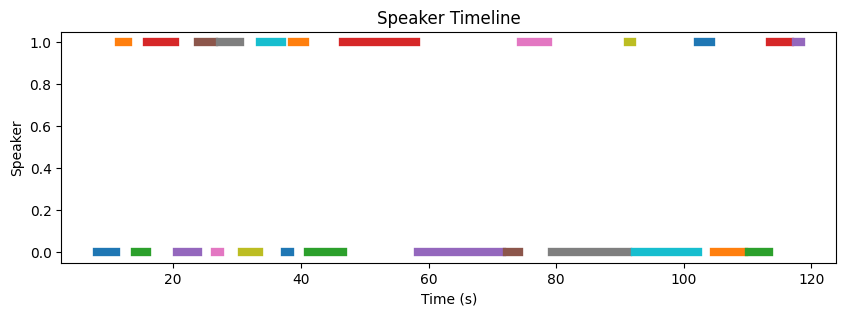

No model was supplied, defaulted to distilbert/distilbert-base-uncased-finetuned-sst-2-english and revision 714eb0f (https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.


🕒 Speaker 0: 62.89s (61.7%)
🕒 Speaker 1: 39.08s (38.3%)

🔹 STEP 4: Analyzing Conversation...
❓ Questions Asked: 8

🗨️ Longest Monologue: 13.15 sec



Device set to use cpu


😊 Sentiment: POSITIVE (1.00)

💡 Insight: Many questions asked. Ensure they are open-ended.



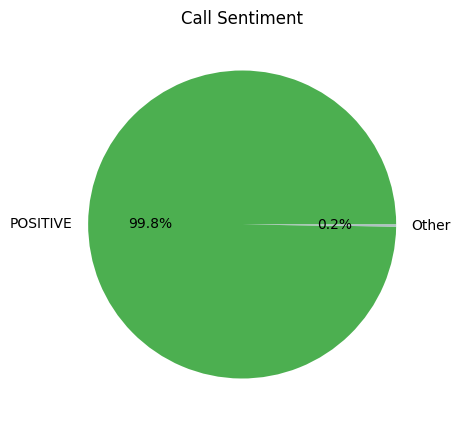


📊  FINAL SUMMARY
🕒 Talk-Time Ratio:
   Sales: 61.7%
   Customer: 38.3%
❓ Total Questions Asked: 8
🗨️ Longest Monologue: 13.15 sec
😊 Overall Sentiment: POSITIVE
💡 Actionable Insight: Many questions asked. Ensure they are open-ended.
✅ Analysis Complete!
📂 Processed Audio File: processed_call.wav


In [ ]:
analyze_call("https://www.youtube.com/watch?v=4ostqJD3Psc")